# Feb 27:  Modify existing RTSTRUCT file to overlay over different scans


## Similar to v2 but make it more general so that all that is needed is:
## 1. The project, subject, session and ROI label to be copied
## 2. Which project, subject and session to copy the RTSTRUCT to, as well as any custom label.

### The algorithm will:
### 1. Download the DICOM-RTSTRUCT file to be copied to a temporary location
### 2. Download the DICOMs of the project/subject/session that contours are to be copied to (to a temp location)
### 3. Copy the DICOM-RTSTRUCT file, modify it accordingly, and save it.

### Then after uploading the DICOM-RTSTRUCT file using ROIUploadAssistance tool, verify that the contours are overlaid as expected in the OHIF-Viewer.

In [122]:
import xnat
#xnat.__version__ # 0.3.21
print(f'XNATpy version = {xnat.__version__}') # 0.3.21
import SimpleITK as sitk
import pydicom
import dicom2nifti
import numpy as np
#import math
import matplotlib.pyplot as plt
#from matplotlib import pyplot
import matplotlib.image as mpimg
import os, sys, time
import natsort
import dicom_functions
import explore_dicom_data
from myshow import myshow
import importlib
import cv2
print(f'OpenCV version = {cv2.__version__}') # 4.1.2
import copy
import DicomHelperFuncs
from DicomHelperFuncs import GetDicomFpaths
from ModifyROIs import ModifyROIs
from PlotDICOMsAndROIs import PlotDICOMsAndROIs
import importlib

#import ModifyROIs
#importlib.reload(ModifyROIs)
#from ModifyROIs import ModifyROIs

XNATpy version = 0.3.21
OpenCV version = 4.1.2


# Connect to XNAT server:

In [2]:
xnatAddress = 'http://10.1.1.17'

session = xnat.connect(xnatAddress, user='admin', password='admin')
#session = xnat.connect(xnatAddress, user='admin', password='admin', debug=True)
session

# Download the data from XNAT

### Define the REST path variables:

In [157]:
# Define the REST variables that point to the DICOM-RTSTRUCT file to be copied:

RoiProjLab = 'BrainTumorProg'
RoiSubjLab = 'PGBM-002'
##fromExpNo = 0 # (= 1 in XNAT web app; e.g. ‘PGM-002_MR_1’)
RoiExpLab = 'PGBM-002_MR_1'
RoiLab = 'RTSTRUCT_20200123_145731'
##fromScanNo = 0 # 0 -> T1post
##fromScanLabel = 'T1post'

# Define the REST variables that point to the DICOM files that the ROI applies to:

fromDicomProjLab = 'BrainTumorProg'
fromDicomSubjLab = 'PGBM-002'
##toExpNo = 0 # (= 1 in XNAT web app; e.g. ‘PGM-002_MR_1’)
fromDicomExpLab = 'PGBM-002_MR_1'
##toScanNo = 0 # 0 -> T1post
fromDicomScanLab = 'T1post'

# Define the REST variables that point to the DICOM files that the ROI is to be applied to:

toDicomProjLab = 'BrainTumorProg'
#toDicomSubjLab = 'PGM-002'
toDicomSubjLab = 'PGBM-002'
##toExpNo = 0 # (= 1 in XNAT web app; e.g. ‘PGM-002_MR_1’)
#toDicomExpLab = 'PGM-002_MR_1'
toDicomExpLab = 'PGBM-002_MR_2'
##toScanNo = 0 # 0 -> T1post
toDicomScanLab = 'T1post'

In [5]:
# Verify that the above variables are correct:


print('DICOM-RTSTRUCT:\n\n')

print('session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors:\n')
print(session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors)
print('\n\n')
#print(session.projects[toProjLab].subjects[toSubjLab].experiments[toExpLab].assessors)
#print('\n\n')
print('session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab]:\n')
print(session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab])
print('\n\n')
print('session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources:\n')
print(session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources)
print('\n\n')
#print('fromProjLab/fromSubjLab/fromExpLab/fromRoiLab/resources[0]:\n')
#print(session.projects[RoiProjLab].subjects[fromSubjLab].experiments[fromExpLab].assessors[fromRoiLab].resources[0])
#print('\n\n')
#print('fromProjLab/fromSubjLab/fromExpLab/fromRoiLab/resources[1]: (these need to be downloaded)\n')
#print(session.projects[fromProjLab].subjects[fromSubjLab].experiments[fromExpLab].assessors[fromRoiLab].resources[1])
#print('\n\n')
print('session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources[''RTSTRUCT'']:\n')
print(session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources['RTSTRUCT'])
print('\n\n')
print('session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources[''RTSTRUCT''].label:\n')
print(session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources['RTSTRUCT'].label)
print('\n\n')
print('session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources[''RTSTRUCT''].id:\n')
print(session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources['RTSTRUCT'].id)
print('\n\n')
print('session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources[''RTSTRUCT''].description:\n')
print(session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources['RTSTRUCT'].description)
print('\n\n')
print('session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources[''RTSTRUCT''].files:\n')
print(session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources['RTSTRUCT'].files)
print('\n\n')
print('session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources[''RTSTRUCT''].files[0]:\n')
print(session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources['RTSTRUCT'].files[0])
print('\n\n')
#print('fromProjLab/fromSubjLab/fromExpLab/fromRoiLab/resources["RTSTRUCT"].files[0].file_name_uuid:\n')
#print(session.projects[fromProjLab].subjects[fromSubjLab].experiments[fromExpLab].assessors[fromRoiLab].resources['RTSTRUCT'].files[0].file_name_uuid)
#print('\n\n')
#print('fromProjLab/fromSubjLab/fromExpLab/fromRoiLab/resources["RTSTRUCT"].files[0].name:\n')
#print(session.projects[fromProjLab].subjects[fromSubjLab].experiments[fromExpLab].assessors[fromRoiLab].resources['RTSTRUCT'].files[0].name)
#print('\n\n')
print('session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources[''RTSTRUCT''].files[0].id:\n')
print(session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources['RTSTRUCT'].files[0].id)
print('\n\n')


print('\n\nDICOMs:\n\n')

print('session.projects[fromDicomProjLab].subjects[fromDicomSubjLab].experiments[fromDicomExpLab].scans:\n')
print(session.projects[fromDicomProjLab].subjects[fromDicomSubjLab].experiments[fromDicomExpLab].scans)
print('\n\n')
print('session.projects[fromDicomProjLab].subjects[fromDicomSubjLab].experiments[fromDicomExpLab].scans[fromDicomScanLab]:\n')
print(session.projects[fromDicomProjLab].subjects[fromDicomSubjLab].experiments[fromDicomExpLab].scans[fromDicomScanLab])
print('\n\n')
print('session.projects[fromDicomProjLab].subjects[fromDicomSubjLab].experiments[fromDicomExpLab].scans[fromDicomScanLab].files:\n')
print(session.projects[fromDicomProjLab].subjects[fromDicomSubjLab].experiments[fromDicomExpLab].scans[fromDicomScanLab].files)
print('\n\n')
print('session.projects[fromDicomProjLab].subjects[fromDicomSubjLab].experiments[fromDicomExpLab].scans[fromDicomScanLab].files[0]:\n')
print(session.projects[fromDicomProjLab].subjects[fromDicomSubjLab].experiments[fromDicomExpLab].scans[fromDicomScanLab].files[0])
print('\n\n')
#print('session.projects[toProjLab].subjects[toSubjLab].experiments[toExpLab].scans[toScanLab].files[0].name:\n')
#print(session.projects[toProjLab].subjects[toSubjLab].experiments[toExpLab].scans[toScanLab].files[0].name)
#print('\n\n')
print('session.projects[fromDicomProjLab].subjects[fromDicomSubjLab].experiments[fromDicomExpLab].scans[fromDicomScanLab].files[0].id:\n')
print(session.projects[fromDicomProjLab].subjects[fromDicomSubjLab].experiments[fromDicomExpLab].scans[fromDicomScanLab].files[0].id)
print('\n\n')
print('len(session.projects[fromDicomProjLab].subjects[fromDicomSubjLab].experiments[fromDicomExpLab].scans[fromDicomScanLab].files):\n')
print(len(session.projects[fromDicomProjLab].subjects[fromDicomSubjLab].experiments[fromDicomExpLab].scans[fromDicomScanLab].files))
print('\n\n')
#print('len(session.projects[toProjLab].subjects[toSubjLab].experiments[toExpLab].scans[toScanLab]):\n')
#print(len(session.projects[toProjLab].subjects[toSubjLab].experiments[toExpLab].scans[toScanLab]))
#print('\n\n')

DICOM-RTSTRUCT:


session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors:

<XNATListing {(RoiCollection_hkXcqO5_3NihONdaV2u, AIM_20200227_152156): <RoiCollectionData AIM_20200227_152156 (RoiCollection_hkXcqO5_3NihONdaV2u)>, (RoiCollection_hkXcqO5_7uUu8kZZIJA, RTSTRUCT_20200123_145731): <RoiCollectionData RTSTRUCT_20200123_145731 (RoiCollection_hkXcqO5_7uUu8kZZIJA)>, (RoiCollection_hkXcqO5_8KjaDskViVo, RTSTRUCT_20200224_170303): <RoiCollectionData RTSTRUCT_20200224_170303 (RoiCollection_hkXcqO5_8KjaDskViVo)>, (RoiCollection_hkXcqO5_9cGHptW15Ho, RTSTRUCT_20200224_123600): <RoiCollectionData RTSTRUCT_20200224_123600 (RoiCollection_hkXcqO5_9cGHptW15Ho)>}>



session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab]:

<RoiCollectionData RTSTRUCT_20200123_145731 (RoiCollection_hkXcqO5_7uUu8kZZIJA)>



session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources:

<XNATListing {(946, RTSTRUCT)

### Download files from XNAT to temporary directory:

In [158]:
# Define the directories to download files to:
fromDicomDir = r'C:\Temp\From DICOM'
fromRoiDir = r'C:\Temp\From RTSTRUCT'

toDicomDir = r'C:\Temp\To DICOM'
toRoiDir = r'C:\Temp\To RTSTRUCT'

# Combine all directory paths:
allDirs = [fromRoiDir, fromDicomDir, toRoiDir, toDicomDir]

# Create directories if they don't exist:
for dirPath in allDirs:
    try:
        os.mkdir(dirPath)
        print('Directory', dirPath, 'created')
    except FileExistsError:
        print('Directory', dirPath, 'already exists')

""" Note:
Using .download_dir(directory) downloads to a complicated XNAT-like folder structure,
so instead will use .download(full_file_path) """

# Get the DICOM-RTSTRUCT object:
roi = session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources['RTSTRUCT'].files[0]

# Get the filename:
roiId = roi.id

# The ROI filepath:
fromRoiFpath = os.path.join(fromRoiDir, roiId)

# Download the DICOM-RTSTRUCT file:
print('\nDownloading the DICOM-RTSTRUCT file to be copied..', roiId)
roi.download(fromRoiFpath)


# Get the DICOM objects of the series the ROIs relate to:
#dicoms = session.projects[DicomProjLab].subjects[DicomSubjLab].experiments[DicomExpLab].scans[DicomScanLab].files
dicoms = session.projects[fromDicomProjLab].subjects[fromDicomSubjLab].experiments[fromDicomExpLab].scans[fromDicomScanLab]

# Iterate for each file in dicomObjects:
print('\nDownloading the DICOM files that the DICOM-RTSTRUCT file relate to..')
for f in range(len(dicoms.files)):
    # Get the filename:
    dicomId = dicoms.files[f].id
    
    # Download the DICOM:
    print('\n     Downloading DICOM file', dicomId)
    dicoms.files[f].download(os.path.join(fromDicomDir, dicomId))
    
    
# Get the DICOM objects of the series the ROIs are to be overlaid to:
#dicoms = session.projects[DicomProjLab].subjects[DicomSubjLab].experiments[DicomExpLab].scans[DicomScanLab].files
dicoms = session.projects[toDicomProjLab].subjects[toDicomSubjLab].experiments[toDicomExpLab].scans[toDicomScanLab]

# Iterate for each file in dicomObjects:
print('\nDownloading the DICOM files that the DICOM-RTSTRUCT file is to be overlaid on..')
for f in range(len(dicoms.files)):
    # Get the filename:
    dicomId = dicoms.files[f].id
    
    # Download the DICOM:
    print('\n     Downloading DICOM file', dicomId)
    dicoms.files[f].download(os.path.join(toDicomDir, dicomId))

100% of 157.5 KiB |################################|  52.7 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  47.2 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  34.6 MiB/s Time:  0:00:00


Directory C:\Temp\From RTSTRUCT already exists
Directory C:\Temp\From DICOM already exists
Directory C:\Temp\To RTSTRUCT already exists
Directory C:\Temp\To DICOM already exists







100% of 517.9 KiB |################################|  47.2 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  64.9 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  52.0 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  43.3 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  57.7 MiB/s Time:  0:00:00


100% of 517.9 KiB |################################|  56.0 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  57.7 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  64.9 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  39.5 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  47.3 MiB/s Time:  0:00:00


100% of 517.9 KiB |################################|  40.0 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  43.5 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  41.4 MiB/s Time:  0:00:00


100% of 517.9 KiB |################################|  51.9 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  47.2 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  51.9 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  57.8 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  47.2 MiB/s Time:  0:00:00


100% of 517.9 KiB |################################|  52.0 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  51.8 MiB/s Time:  0:00:00
100% of 611.0 KiB |################################|  43.8 MiB/s Time:  0:00:00
100% of 167.2 KiB |################################|  55.9 MiB/s Time:  0:00:00


100% of 517.6 KiB |################################|  20.0 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  23.9 MiB/s Time:  0:00:00


100% of 517.6 KiB |################################|  16.8 MiB/s Time:  0:00:00
N/A% of 517.6 KiB |                                  |   0.0 s/B ETA:  --:--:--

100% of 517.6 KiB |################################|  12.8 MiB/s Time:  0:00:00


100% of 517.6 KiB |################################|  28.8 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  12.6 MiB/s Time:  0:00:00


100% of 517.6 KiB |################################|  10.2 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  13.3 MiB/s Time:  0:00:00


100% of 517.6 KiB |################################|  27.2 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  19.6 MiB/s Time:  0:00:00


100% of 517.6 KiB |################################|  24.1 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  28.0 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  34.6 MiB/s Time:  0:00:00


100% of 517.6 KiB |################################|  28.8 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  16.7 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  28.8 MiB/s Time:  0:00:00


100% of 517.6 KiB |################################|  34.6 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  34.6 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  27.3 MiB/s Time:  0:00:00


100% of 517.6 KiB |################################|  32.5 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  43.3 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  34.6 MiB/s Time:  0:00:00


100% of 579.5 KiB |################################|  38.8 MiB/s Time:  0:00:00
100% of 159.6 KiB |################################|  20.0 MiB/s Time:  0:00:00


### Use ModifyROIs to copy the contour data, modify and save to toRoiDir:

In [166]:
import ModifyROIs
importlib.reload(ModifyROIs)
from ModifyROIs import ModifyROIs

toRoiFpath = ModifyROIs(fromDicomDir, fromRoiFpath, toDicomDir, toRoiDir)

# Wrap up the above into a function "CopyROI":

In [106]:
# Create a dictionary to store various variables to input into CopyROI():

xnatDict = {# Define the XNAT login details:
            'xnatAddress':'http://10.1.1.17',\
            'username':'admin',\
            'password':'admin',\
    
            # Define the REST variables that point to the ROIs to be copied:
            'RoiProjLab':'BrainTumorProg',\
            'RoiSubjLab':'PGBM-002',\
            'RoiExpLab':'PGBM-002_MR_1',\
            'RoiLab':'RTSTRUCT_20200123_145731',\
    
            # Define the REST variables that point to the DICOM files that the ROI applies to:
            'fromDicomProjLab':'BrainTumorProg',\
            'fromDicomSubjLab':'PGBM-002',\
            'fromDicomExpLab':'PGBM-002_MR_1',\
            'fromDicomScanLab':'T1post',\
    
            # Define the REST variables that point to the DICOM files that the ROI is to be applied to:
            'toDicomProjLab':'BrainTumorProg',\
            #'toDicomSubjLab':'PGM-002',\
            'toDicomSubjLab':'PGBM-002',\
            #'toDicomExpLab':'PGM-002_MR_1',\
            'toDicomExpLab':'PGBM-002_MR_2',\
            'toDicomScanLab':'T1post',\
    
            # Define the directories to download files to:
            'fromDicomDir':r'C:\Temp\From DICOM',\
            'fromRoiDir':r'C:\Temp\From RTSTRUCT',\
            'toDicomDir':r'C:\Temp\To DICOM',\
            'toRoiDir':r'C:\Temp\To RTSTRUCT'
           }

In [156]:
import CopyROIs
importlib.reload(CopyROIs)
from CopyROIs import CopyROIs

toRoiFpath = CopyROIs(xnatDict, debug=True)
#toRoiFpath = CopyROIs(xnatDict, debug=False)

The input variables (xnatDict):


{'xnatAddress': 'http://10.1.1.17', 'username': 'admin', 'password': 'admin', 'RoiProjLab': 'BrainTumorProg', 'RoiSubjLab': 'PGBM-002', 'RoiExpLab': 'PGBM-002_MR_1', 'RoiLab': 'RTSTRUCT_20200123_145731', 'fromDicomProjLab': 'BrainTumorProg', 'fromDicomSubjLab': 'PGBM-002', 'fromDicomExpLab': 'PGBM-002_MR_1', 'fromDicomScanLab': 'T1post', 'toDicomProjLab': 'BrainTumorProg', 'toDicomSubjLab': 'PGBM-002', 'toDicomExpLab': 'PGBM-002_MR_2', 'toDicomScanLab': 'T1post', 'fromDicomDir': 'C:\\Temp\\From DICOM', 'fromRoiDir': 'C:\\Temp\\From RTSTRUCT', 'toDicomDir': 'C:\\Temp\\To DICOM', 'toRoiDir': 'C:\\Temp\\To RTSTRUCT'}



Directory C:\Temp\From RTSTRUCT already exists
Directory C:\Temp\From DICOM already exists
Directory C:\Temp\To RTSTRUCT already exists
Directory C:\Temp\To DICOM already exists


100% of 157.5 KiB |################################|  52.7 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  43.3 MiB/s Time:  0:00:00


100% of 517.9 KiB |################################|  52.0 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  51.9 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  40.0 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  47.2 MiB/s Time:  0:00:00


100% of 517.9 KiB |################################|  20.8 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  43.3 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  47.2 MiB/s Time:  0:00:00
N/A% of 517.9 KiB |                                  |   0.0 s/B ETA:  --:--:--

100% of 517.9 KiB |################################|  40.0 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  32.5 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  32.5 MiB/s Time:  0:00:00
N/A% of 517.9 KiB |                                  |   0.0 s/B ETA:  --:--:--

100% of 517.9 KiB |################################|  40.0 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  52.0 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  57.7 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  30.6 MiB/s Time:  0:00:00
N/A% of 517.9 KiB |                                  |   0.0 s/B ETA:  --:--:--

100% of 517.9 KiB |################################|  22.6 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  57.8 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  47.2 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  57.7 MiB/s Time:  0:00:00


100% of 517.9 KiB |################################|  57.8 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  52.0 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  51.9 MiB/s Time:  0:00:00
100% of 611.0 KiB |################################|  47.2 MiB/s Time:  0:00:00
100% of 167.2 KiB |################################|  41.9 MiB/s Time:  0:00:00


100% of 517.6 KiB |################################|  65.2 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  64.9 MiB/s Time:  0:00:00
N/A% of 517.6 KiB |                                  |   0.0 s/B ETA:  --:--:--

100% of 517.6 KiB |################################|  47.2 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  57.6 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  43.3 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  47.2 MiB/s Time:  0:00:00
N/A% of 517.6 KiB |                                  |   0.0 s/B ETA:  --:--:--

100% of 517.6 KiB |################################|  57.7 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  57.7 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  57.7 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  64.9 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  47.2 MiB/s Time:  0:00:00


100% of 517.6 KiB |################################|  49.2 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  57.7 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  54.9 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  43.3 MiB/s Time:  0:00:00


100% of 517.6 KiB |################################|  39.9 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  43.3 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  51.9 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  30.6 MiB/s Time:  0:00:00


100% of 517.6 KiB |################################|  27.3 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  34.6 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  37.1 MiB/s Time:  0:00:00
100% of 579.5 KiB |################################|  64.6 MiB/s Time:  0:00:00


100% of 159.6 KiB |################################|  53.3 MiB/s Time:  0:00:00



New DICOM-RTSTRUCT file saved to:

 C:\Temp\To RTSTRUCT\RTSTRUCT_20200228_202426.dcm 


JSON file created:
 C:\Temp\To RTSTRUCT\RTSTRUCT_20200228_202426.json 


Deleting temporary DICOM files..


In [70]:
toRoiFpath

'C:\\Temp\\To RTSTRUCT\\RTSTRUCT_20200228_125859.dcm'

In [74]:
toRoiFname = os.path.split(toRoiFpath)[1]
toRoiFname

'RTSTRUCT_20200228_125859.dcm'

In [77]:
jsonFname = os.path.splitext(toRoiFname)[0] + '.json'
jsonFname

'RTSTRUCT_20200228_125859.json'

# The contours from PGBM-002_MR_1 do not overlay correctly on PGMB-002_MR_2 since the Patient Orientations differ.
# So more work will be required to take into account differences in orientation (and ideally slice position):

In [159]:
# Test stuff out:

# The filepaths of the original DICOMs:
fpaths1 = GetDicomFpaths(fromDicomDir)
    
# The ROIs that belong to the DICOMs in fpaths1 is:
roi1 = pydicom.dcmread(fromRoiFpath)

# Load the first DICOM from the original series:
dicom1 = pydicom.read_file(fpaths1[0])

dicom1

(0008, 0005) Specific Character Set              CS: 'ISO_IR 100'
(0008, 0008) Image Type                          CS: ['ORIGINAL', 'PRIMARY', 'OTHER']
(0008, 0016) SOP Class UID                       UI: MR Image Storage
(0008, 0018) SOP Instance UID                    UI: 1.3.6.1.4.1.14519.5.2.1.4429.7055.261648268414748489539476953118
(0008, 0020) Study Date                          DA: '19960813'
(0008, 0021) Series Date                         DA: '19960813'
(0008, 0022) Acquisition Date                    DA: '19960813'
(0008, 0023) Content Date                        DA: '19960813'
(0008, 0030) Study Time                          TM: '164104.000000'
(0008, 0031) Series Time                         TM: '162908'
(0008, 0032) Acquisition Time                    TM: '162908'
(0008, 0033) Content Time                        TM: '162908'
(0008, 0050) Accession Number                    SH: '7351166753651521'
(0008, 0060) Modality                            CS: 'MR'
(0008, 0070) Manufa

In [160]:
# The filepaths of the other DICOMs:
fpaths2 = GetDicomFpaths(toDicomDir)

# Load the first DICOM from the other series:
dicom2 = pydicom.read_file(fpaths2[0])

dicom2

(0008, 0005) Specific Character Set              CS: 'ISO_IR 100'
(0008, 0008) Image Type                          CS: ['ORIGINAL', 'PRIMARY', 'OTHER']
(0008, 0016) SOP Class UID                       UI: MR Image Storage
(0008, 0018) SOP Instance UID                    UI: 1.3.6.1.4.1.14519.5.2.1.4429.7055.286127369609007024848788020577
(0008, 0020) Study Date                          DA: '19970117'
(0008, 0021) Series Date                         DA: '19970117'
(0008, 0022) Acquisition Date                    DA: '19970117'
(0008, 0023) Content Date                        DA: '19970117'
(0008, 0030) Study Time                          TM: '112200'
(0008, 0031) Series Time                         TM: '115444'
(0008, 0032) Acquisition Time                    TM: '115444'
(0008, 0033) Content Time                        TM: '115444'
(0008, 0050) Accession Number                    SH: '8701449723783444'
(0008, 0060) Modality                            CS: 'MR'
(0008, 0070) Manufacturer 

In [161]:
print('dicom1.FrameOfReferenceUID =', dicom1.FrameOfReferenceUID)
print('dicom1.InStackPositionNumber =', dicom1.InStackPositionNumber)
print('dicom1.ImagesInAcquisition =', dicom1.ImagesInAcquisition)
print('dicom1.ImagePositionPatient =', dicom1.ImagePositionPatient)
print('dicom1.ImageOrientationPatient =', dicom1.ImageOrientationPatient)
print('dicom1.SliceLocation =', dicom1.SliceLocation)
print('')
print('dicom2.FrameOfReferenceUID =', dicom2.FrameOfReferenceUID)
print('dicom2.InStackPositionNumber =', dicom2.InStackPositionNumber)
print('dicom2.ImagesInAcquisition =', dicom2.ImagesInAcquisition)
print('dicom2.ImagePositionPatient =', dicom2.ImagePositionPatient)
print('dicom2.ImageOrientationPatient =', dicom2.ImageOrientationPatient)
print('dicom2.SliceLocation =', dicom2.SliceLocation)

dicom1.FrameOfReferenceUID = 1.3.6.1.4.1.14519.5.2.1.4429.7055.250487807866145927413117906224
dicom1.InStackPositionNumber = 1
dicom1.ImagesInAcquisition = 22
dicom1.ImagePositionPatient = ['-115.545', '-132.514', '-54.8027']
dicom1.ImageOrientationPatient = ['0.997673', '-0.03833', '0.056381', '0.0475315', '0.98392', '-0.172172']
dicom1.SliceLocation = -67.5147934

dicom2.FrameOfReferenceUID = 1.3.6.1.4.1.14519.5.2.1.4429.7055.306844427566369915784964303427
dicom2.InStackPositionNumber = 1
dicom2.ImagesInAcquisition = 22
dicom2.ImagePositionPatient = ['-106.109', '-186.371', '-42.7965']
dicom2.ImageOrientationPatient = ['0.999679', '0.02533', '0', '-0.0244148', '0.963561', '-0.26637']
dicom2.SliceLocation = -72.0400238


In [162]:
list(fpaths1)

['C:\\Temp\\From DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.331058148523327901159449546313-11-1-xb6jdm.dcm',
 'C:\\Temp\\From DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.331058148523327901159449546313-11-2-119a4or.dcm',
 'C:\\Temp\\From DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.331058148523327901159449546313-11-3-o6pfci.dcm',
 'C:\\Temp\\From DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.331058148523327901159449546313-11-4-1ji0ody.dcm',
 'C:\\Temp\\From DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.331058148523327901159449546313-11-5-1kyxtoq.dcm',
 'C:\\Temp\\From DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.331058148523327901159449546313-11-6-ui6tn3.dcm',
 'C:\\Temp\\From DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.331058148523327901159449546313-11-7-2g5trn.dcm',
 'C:\\Temp\\From DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.331058148523327901159449546313-11-8-11aj08n.dcm',
 'C:\\Temp\\From DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.331058148523327901159449546313-11-9-ouxf6l.dcm',
 'C:\\Temp\\From DICOM\\1.3.6.1.4

In [163]:
list(fpaths2)

['C:\\Temp\\To DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.290332099546120305394775536058-12-1-1scwb9f.dcm',
 'C:\\Temp\\To DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.290332099546120305394775536058-12-2-1jo0m2n.dcm',
 'C:\\Temp\\To DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.290332099546120305394775536058-12-3-bhrzsv.dcm',
 'C:\\Temp\\To DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.290332099546120305394775536058-12-4-1qwodxk.dcm',
 'C:\\Temp\\To DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.290332099546120305394775536058-12-5-yntnhr.dcm',
 'C:\\Temp\\To DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.290332099546120305394775536058-12-6-ybkmts.dcm',
 'C:\\Temp\\To DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.290332099546120305394775536058-12-7-3bu76g.dcm',
 'C:\\Temp\\To DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.290332099546120305394775536058-12-8-1cqw9ym.dcm',
 'C:\\Temp\\To DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.290332099546120305394775536058-12-9-p0pbjb.dcm',
 'C:\\Temp\\To DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.

In [167]:
roi1

(0008, 0016) SOP Class UID                       UI: RT Structure Set Storage
(0008, 0018) SOP Instance UID                    UI: 1.2.826.0.1.534147.578.4208788039.20200231457312
(0008, 0020) Study Date                          DA: '19960813'
(0008, 0030) Study Time                          TM: '162908'
(0008, 0050) Accession Number                    SH: ''
(0008, 0060) Modality                            CS: 'RTSTRUCT'
(0008, 0070) Manufacturer                        LO: 'GE MEDICAL SYSTEMS'
(0008, 0090) Referring Physician's Name          PN: ''
(0008, 1070) Operators' Name                     PN: ''
(0008, 1090) Manufacturer's Model Name           LO: 'Optima MR450w'
(0010, 0010) Patient's Name                      PN: 'PGM-002'
(0010, 0020) Patient ID                          LO: 'PGM-002_MR_1'
(0010, 0030) Patient's Birth Date                DA: '00021130'
(0010, 0040) Patient's Sex                       CS: 'M'
(0018, 1020) Software Version(s)                 LO: ['25', 'LX', '

In [168]:
# Read in the modified ROI:

newRoiFname = 'RTSTRUCT_20200228_113800.dcm'
newRoiFname = 'RTSTRUCT_20200228_115243.dcm'
newRoiFname = 'RTSTRUCT_20200228_203013.dcm'
newRoiFpath = os.path.join(toRoiDir, newRoiFname)

roi2 = pydicom.dcmread(newRoiFpath)
roi2

(0008, 0016) SOP Class UID                       UI: RT Structure Set Storage
(0008, 0018) SOP Instance UID                    UI: 1.2.826.0.1.534147.578.4208788039.20200231457312
(0008, 0020) Study Date                          DA: '19970117'
(0008, 0030) Study Time                          TM: '112200'
(0008, 0050) Accession Number                    SH: ''
(0008, 0060) Modality                            CS: 'RTSTRUCT'
(0008, 0070) Manufacturer                        LO: 'GE MEDICAL SYSTEMS'
(0008, 0090) Referring Physician's Name          PN: ''
(0008, 1070) Operators' Name                     PN: ''
(0008, 1090) Manufacturer's Model Name           LO: 'Optima MR450w'
(0010, 0010) Patient's Name                      PN: 'PGBM-002'
(0010, 0020) Patient ID                          LO: 'PGBM-002'
(0010, 0030) Patient's Birth Date                DA: ''
(0010, 0040) Patient's Sex                       CS: 'M'
(0018, 1020) Software Version(s)                 LO: ['25', 'LX', 'MR Software

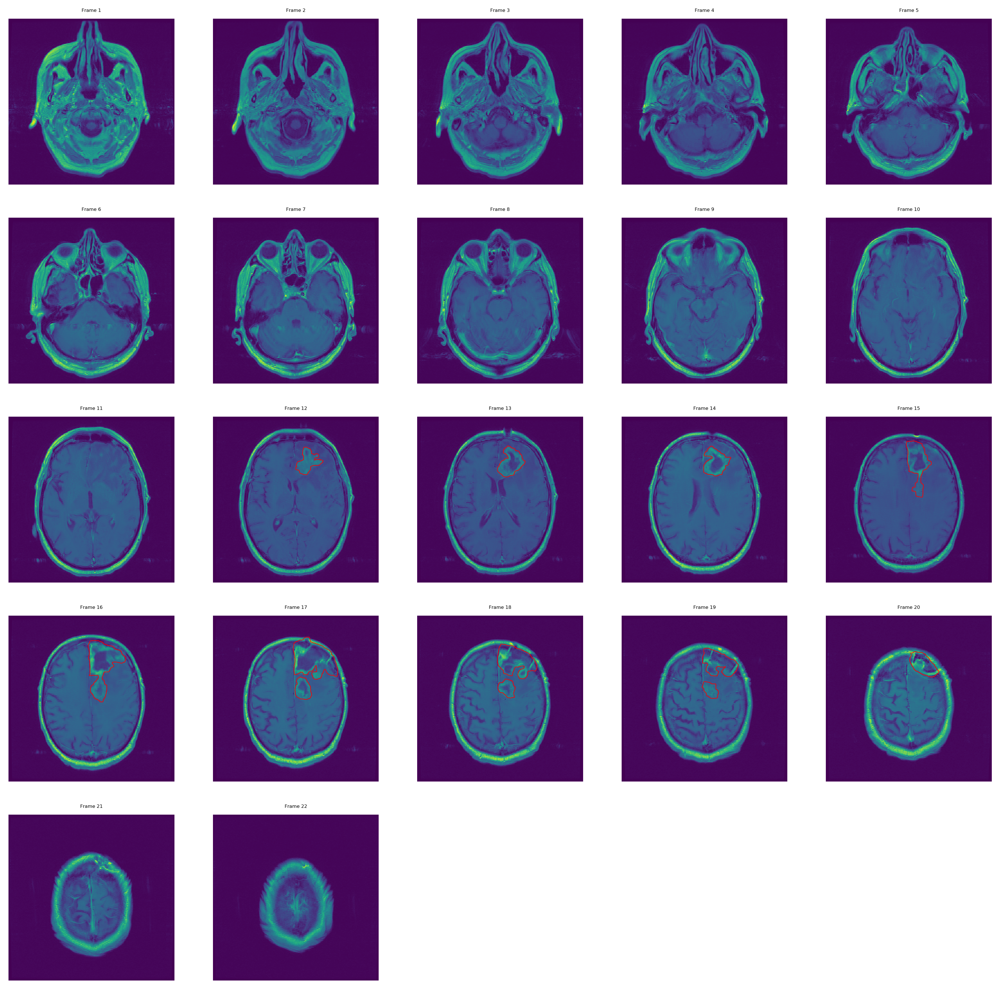

In [165]:
# Define location for plots to be exported to:
exportDir = r'C:\Code\WP1.3_multiple_modalities\trying stuff\plots'

# Decide whether to export plot:
exportPlot = False # no
#exportPlot = True # yes

import PlotDICOMsAndROIs
importlib.reload(PlotDICOMsAndROIs)
from PlotDICOMsAndROIs import PlotDICOMsAndROIs

# First plot the original DICOM series and their corresponding ROIs:
dataDict1 = PlotDICOMsAndROIs(dicomsPath=fromDicomDir, roiPath=fromRoiFpath, exportPlot=exportPlot, exportDir=exportDir)

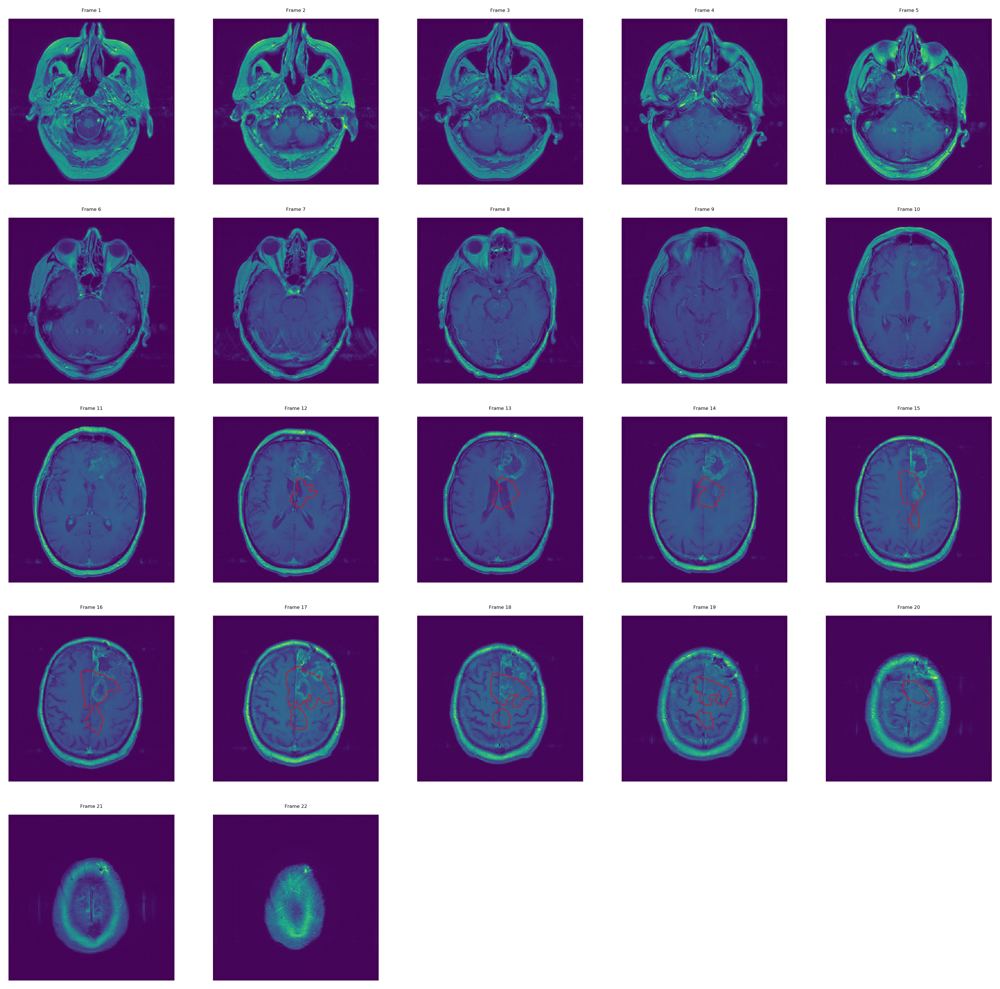

In [169]:
# Plot the new DICOM series with the ROIs from the original DICOM series:
dataDict2 = PlotDICOMsAndROIs(dicomsPath=toDicomDir, roiPath=toRoiFpath, exportPlot=exportPlot, exportDir=exportDir)

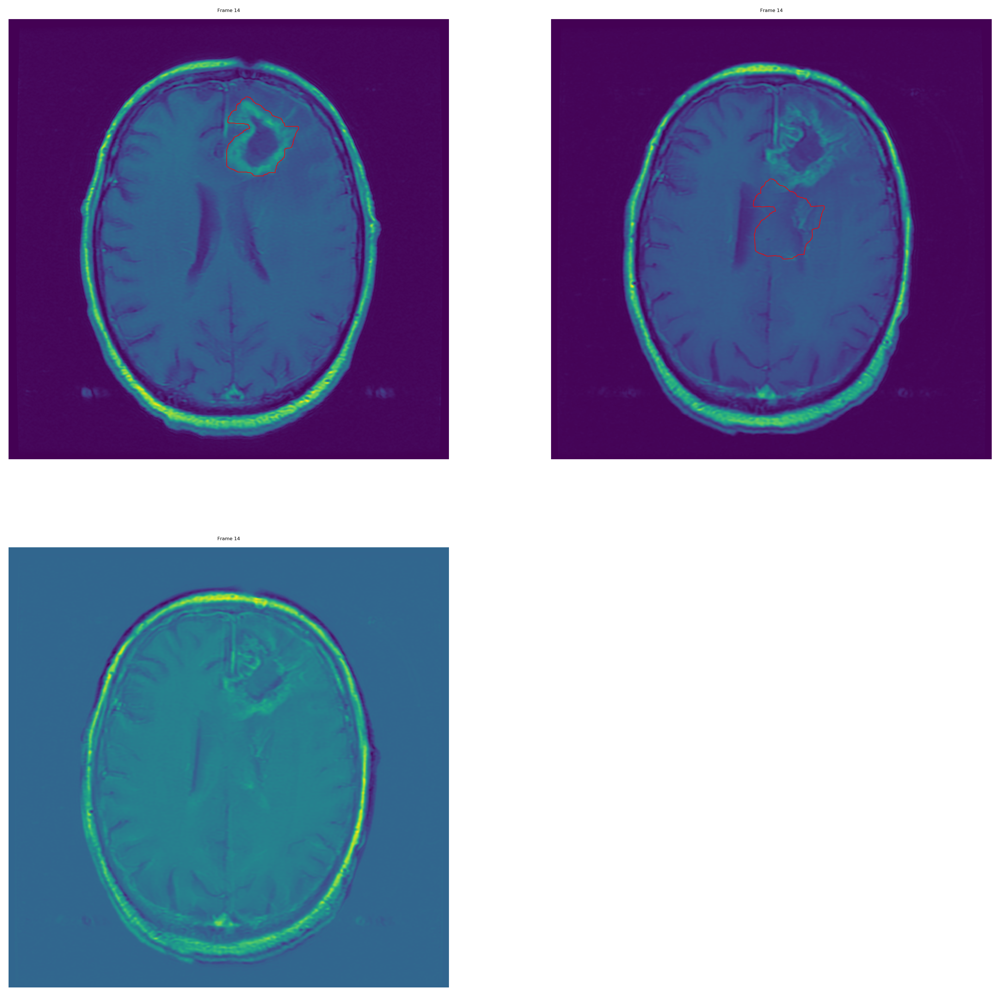

In [174]:
keys1 = list(dataDict1.keys())
keys2 = list(dataDict2.keys())

k = 13

#dataDict1[keys1[k]]

# Set the title font:
fontSize=4

rows = 2
cols = 2

flip = True

plt.figure(figsize=(15,15), dpi=300);
    
i = 0 # for subplot pos

for dictionary in [dataDict1, dataDict2]:
    
    keys = list(dictionary.keys())

    frameNo = dictionary[keys[k]]['Frame number']
    pixArray = dictionary[keys[k]]['Pixel array']
    Ncontours = dictionary[keys[k]]['Number of contours']
    contourPts = dictionary[keys[k]]['Contour points']

    # Plot the pixel array:
    i = i + 1    
    plt.subplot(rows,cols,i, aspect='equal')
    if flip:
        plt.pcolormesh(np.flipud(pixArray));
    else:
        plt.pcolormesh(pixArray);

    plt.title(f'Frame {frameNo}', size=fontSize);
    plt.axis('off');

    # Plot the contours:
    if Ncontours > 0:   
        for c in range(Ncontours):
            # Unpack tuple and store each x,y tuple in arrays X and Y:
            X = []
            Y = []
            for x, y in contourPts[c]:
                X.append(x)
                Y.append(y)

    # Flip Y pixel coordinates if flip=True:
    if flip:
        N_r, N_c = np.shape(pixArray)

        Y = N_c - np.array(Y)

    plt.plot(X, Y, linewidth=0.5, c='red');
    
    
# Plot the difference:
i = i + 1    
plt.subplot(rows,cols,i, aspect='equal')
if flip:
    plt.pcolormesh(np.flipud(dataDict2[keys2[k]]['Pixel array'] - dataDict1[keys1[k]]['Pixel array']));
else:
    plt.pcolormesh(dataDict2[keys2[k]]['Pixel array'] - dataDict1[keys1[k]]['Pixel array']);

plt.title(f'Frame {frameNo}', size=fontSize);
plt.axis('off');

In [161]:
print('dicom1.FrameOfReferenceUID =', dicom1.FrameOfReferenceUID)
print('dicom1.InStackPositionNumber =', dicom1.InStackPositionNumber)
print('dicom1.ImagesInAcquisition =', dicom1.ImagesInAcquisition)
print('dicom1.ImagePositionPatient =', dicom1.ImagePositionPatient)
print('dicom1.ImageOrientationPatient =', dicom1.ImageOrientationPatient)
print('dicom1.SliceLocation =', dicom1.SliceLocation)
print('')
print('dicom2.FrameOfReferenceUID =', dicom2.FrameOfReferenceUID)
print('dicom2.InStackPositionNumber =', dicom2.InStackPositionNumber)
print('dicom2.ImagesInAcquisition =', dicom2.ImagesInAcquisition)
print('dicom2.ImagePositionPatient =', dicom2.ImagePositionPatient)
print('dicom2.ImageOrientationPatient =', dicom2.ImageOrientationPatient)
print('dicom2.SliceLocation =', dicom2.SliceLocation)

dicom1.FrameOfReferenceUID = 1.3.6.1.4.1.14519.5.2.1.4429.7055.250487807866145927413117906224
dicom1.InStackPositionNumber = 1
dicom1.ImagesInAcquisition = 22
dicom1.ImagePositionPatient = ['-115.545', '-132.514', '-54.8027']
dicom1.ImageOrientationPatient = ['0.997673', '-0.03833', '0.056381', '0.0475315', '0.98392', '-0.172172']
dicom1.SliceLocation = -67.5147934

dicom2.FrameOfReferenceUID = 1.3.6.1.4.1.14519.5.2.1.4429.7055.306844427566369915784964303427
dicom2.InStackPositionNumber = 1
dicom2.ImagesInAcquisition = 22
dicom2.ImagePositionPatient = ['-106.109', '-186.371', '-42.7965']
dicom2.ImageOrientationPatient = ['0.999679', '0.02533', '0', '-0.0244148', '0.963561', '-0.26637']
dicom2.SliceLocation = -72.0400238


# OLD STUFF BELOW (IGNORE...)

# Which tags in the DICOM-RTSTRUCT file need to match the DICOM tags?

### I searched for an answer here:
### http://dicom.nema.org/dicom/2013/output/chtml/part03/sect_A.19.html
### maybe the answer is in "Common Instance Reference C.12.2"?:
### http://dicom.nema.org/dicom/2013/output/chtml/part03/sect_C.12.html#sect_C.12.2
### which includes:
###   1.   Referenced Series Sequence
###   2.   Series Instance UID
###   3.   Referenced Instance Sequence
###   4.   Study Instance UID

### Oddly Patient Name wasn't included.
### I'm not sure what is meant by Referenced Series Sequence.
### So I'll focus on Study Instance UID, Series Instance UID and SOP Instance UID

# Insure that the number of frames for T1post are the same as T1pre_reg:

In [10]:
print(f'There are {len(T1postDicomFpaths)} DICOM files for T1post')
print(f'There are {len(T1pre_regDicomFpaths)} DICOM files for T1pre_reg')

There are 22 DICOM files for T1post
There are 22 DICOM files for T1pre_reg


# For now stick to the DICOMs and DICOM-RTSTRUCTs only:

In [30]:
# The full filepaths of the DICOM files that have ROIs are:
fpaths1 = dicom_functions.dc_filepaths(T1postDicomPath)
#list(fpaths1)

# The ROIs that belong to the DICOMs in fpaths1 is:
roi1 = pydicom.dcmread(T1postRoiFpath)

# The full filepaths of the DICOM files that roi1 is to be projected on are:
fpaths2 = dicom_functions.dc_filepaths(T1pre_regDicomPath)
#list(fpaths2)

In [153]:
# Load each DICOM in fpaths1 and fpaths2, reading in the SOP Instance UIDs 
# and store them (this only works if the number of DICOMs in each series
# are the same):

sopuid1 = []
sopuid2 = []

for f in range(len(fpaths1)):
    fpath1 = fpaths1[f]
    fpath2 = fpaths2[f]
    
    # Read in the DICOMs:
    dicom1 = pydicom.read_file(fpath1)
    dicom2 = pydicom.read_file(fpath2)
    
    # Get the SOP Instance UIDs and store them in sopuid1 and sopuid2:
    sopuid1.append(dicom1.SOPInstanceUID)
    sopuid2.append(dicom2.SOPInstanceUID)
    
sopuid1

['1.3.6.1.4.1.14519.5.2.1.4429.7055.261648268414748489539476953118',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.115664596007531053671073165944',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.169453162220744499902187774507',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.734864380385734898876820935746',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.101431260995780376345119294373',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.251618357828351346730378228640',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.751267821424438562393191155989',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.166841956454708342078137174847',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.299047184661620738488048338672',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.342055582703607715039534137474',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.327808621134516359990335462868',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.320280293613596547840725755465',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.677643793103545804182040061154',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.149742284257271356119234155647',
 '1.3.6.1.4.1.14519.5.2.1.4429.705

In [42]:
sopuid2

['1.3.6.1.4.1.14519.5.2.1.4429.7055.233283907881941719564072244301',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.229311946613577908750293591252',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.166222759358564109836781200972',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.260281761551376319012052926852',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.314624233229445105808472586539',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.134751172388152499567446995768',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.224947501724473200441526515924',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.280921859831511411655905606446',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.185312423231525437787795933564',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.187376519838357119604380008301',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.282593567954154218886408192243',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.338593469518349971723407236454',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.183876055143316444686954476030',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.315201021749421570268842096670',
 '1.3.6.1.4.1.14519.5.2.1.4429.705

In [118]:
# Although the Referenced SOP Instance UID from 
#
# Reference Frame of Reference Sequence[0]
# -> RT Referenced Study Sequence[0] 
#   -> RT Referenced Series Sequence[0]
#     -> Contour Image Sequence[n]
#       -> Referenced SOP Instance UID
#
# is the same as that from
#
# Referenced Frame of Reference Sequence[0]
# -> ROI Contour Sequence[0] 
#   -> Contour Sequence[0] 
#     -> Contour Image Sequence[m]
#       -> Referenced SOP Instance UID
#
# the number (n) of images (DICOMs) that have one or more contours 
# is not necessarily the same as the total number (m) of contours.
#
# Store the indeces that relate each "Contour Image Sequence"
# (i.e. each image that has one or more contours) to the file 
# number of the DICOM they relate to, and the indeces that relate 
# each "Contour Sequence" (i.e. each individual contour) to the 
# file number of the DICOM it relates to.

# First iterate through each Contour Image Sequence, storing the 
# Referenced SOP Instance UID, and finding the index of the matching 
# SOP Instance UID from the DICOM:

imageInds = [] # Contour Image Sequence to DICOM file number
imageRefsopuid1 = [] # Ref SOP Instance UID from Contour Image Sequence

# Loop through each Contour Image Sequence:
for sequence in roi1.ReferencedFrameOfReferenceSequence[0].RTReferencedStudySequence[0].RTReferencedSeriesSequence[0].ContourImageSequence:
    # Get the Reference SOP Instance UID:
    uid = sequence.ReferencedSOPInstanceUID
    
    # Store the UID in imageRefsopuid1:
    imageRefsopuid1.append(uid)
    
    # Find the matching index of this UID in sopuid1:
    imageInds.append(sopuid1.index(uid))
    
#print(imageRefsopuid1)
#print(imageInds)


# Next iterate through each Contour Sequence, storing the 
# Referenced SOP Instance UID, and finding the index of the matching 
# SOP Instance UID from the DICOM:

contourInds = [] # Contour Sequence to DICOM file number
contourRefsopuid1 = [] # Ref SOP Instance UID from Contour Sequence

# Loop through each Contour Sequence:
for sequence in roi1.ROIContourSequence[0].ContourSequence:
    # Get the Reference SOP Instance UID:
    uid = sequence.ContourImageSequence[0].ReferencedSOPInstanceUID
    
    # Store the UID in contourRefsopuid1:
    contourRefsopuid1.append(uid)
    
    # Find the matching index of this UID in sopuid1:
    contourInds.append(sopuid1.index(uid))
    
#print(contourRefsopuid1)
#print(contourInds)

In [119]:
imageRefsopuid1

['1.3.6.1.4.1.14519.5.2.1.4429.7055.320280293613596547840725755465',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.677643793103545804182040061154',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.149742284257271356119234155647',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.207269894846632100106605315699',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.337321577215686178552541657021',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.121761661581454976960293845378',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.176309996049760286843247671656',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.213859255991588180723164022910',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.150121483703605657658660963398']

In [120]:
imageInds

[11, 12, 13, 14, 15, 16, 17, 18, 19]

In [121]:
contourRefsopuid1

['1.3.6.1.4.1.14519.5.2.1.4429.7055.320280293613596547840725755465',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.677643793103545804182040061154',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.149742284257271356119234155647',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.207269894846632100106605315699',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.207269894846632100106605315699',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.337321577215686178552541657021',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.337321577215686178552541657021',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.121761661581454976960293845378',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.121761661581454976960293845378',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.121761661581454976960293845378',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.176309996049760286843247671656',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.176309996049760286843247671656',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.176309996049760286843247671656',
 '1.3.6.1.4.1.14519.5.2.1.4429.7055.213859255991588180723164022910',
 '1.3.6.1.4.1.14519.5.2.1.4429.705

In [122]:
contourInds

[11, 12, 13, 14, 14, 15, 15, 16, 16, 16, 17, 17, 17, 18, 18, 19]

# Look for matches between dicom1 and roi1:

print('LOOKING FOR MATCHES BETWEEN THE FIRST SERIES OF DICOMS AND THEIR ROI')
print('********************************************************************\n\n')

print('The SOP Instance UID from the ROI and from DICOMs indexed by imageInds:\n')

print('roi1.SOPInstanceUID   =', roi1.SOPInstanceUID)
print('')
for i in range(len(imageInds)):
    fpath1 = fpaths1[imageInds[i]]
    # Read in the DICOMs:
    dicom1 = pydicom.read_file(fpath1)
    if i==0:
        print('dicom1.SOPInstanceUID =', dicom1.SOPInstanceUID)
    else:
        print('                      =', dicom1.SOPInstanceUID)

print('')
print('')
print('**************************************************************************************************************')
print('')
print('')

print('Study Instance UID and Ref SOP Instance (unexpected match) from the ROI, and DICOM Study Instance UID:\n')

print('roi1.StudyInstanceUID   =', roi1.StudyInstanceUID, '\n')
print('roi1.ReferencedFrameOfReferenceSequence[0].RTReferencedStudySequence[0].ReferencedSOPInstanceUID \n', \
      '                       =', \
      roi1.ReferencedFrameOfReferenceSequence[0].RTReferencedStudySequence[0].ReferencedSOPInstanceUID, '\n')
print('dicom1.StudyInstanceUID =', dicom1.StudyInstanceUID)

print('')
print('')
print('**************************************************************************************************************')
print('')
print('')

print('Series Instance UID from ROI and DICOM:\n')

print('roi1.SeriesInstanceUID   =', roi1.SeriesInstanceUID, '\n')
print('roi1.ReferencedFrameOfReferenceSequence[0].RTReferencedStudySequence[0].RTReferencedSeriesSequence[0].SeriesInstanceUID \n', \
      '                        =', \
      roi1.ReferencedFrameOfReferenceSequence[0].RTReferencedStudySequence[0].RTReferencedSeriesSequence[0].SeriesInstanceUID, '\n')
print('dicom1.SeriesInstanceUID =', dicom1.SeriesInstanceUID)

print('')
print('')
print('**************************************************************************************************************')
print('')
print('')

print('Frame of Reference UID from ROI and DICOM:\n')

print('roi1.FrameOfReferenceUID                                       \n=', roi1.FrameOfReferenceUID, '\n')
print('roi1.ReferencedFrameOfReferenceSequence[0].FrameOfReferenceUID \n=', roi1.ReferencedFrameOfReferenceSequence[0].FrameOfReferenceUID, '\n')
print('roi1.StructureSetROISequence[0].ReferencedFrameOfReferenceUID  \n=', roi1.StructureSetROISequence[0].ReferencedFrameOfReferenceUID, '\n')
print('dicom1.FrameOfReferenceUID                                     \n=', dicom1.FrameOfReferenceUID)
print('')
print('')

print('')
print('')
print('**************************************************************************************************************')
print('')
print('')

print('Referenced SOP Instance UID from Contour Image Sequence and SOP Instance UID from DICOMs \n', 
      '(both indexed by imageInds in turn):\n')

print('roi1.ReferencedFrameOfReferenceSequence[0].RTReferencedStudySequence[0].RTReferencedSeriesSequence[0]\n', \
      '.ContourImageSequence[i].ReferencedSOPInstanceUID')
print('dicom1.SOPInstanceUID \n')
for i in range(len(imageInds)):
    print(roi1.ReferencedFrameOfReferenceSequence[0].RTReferencedStudySequence[0].RTReferencedSeriesSequence[0].ContourImageSequence[i].ReferencedSOPInstanceUID)
    
    # Load the imageInds[i]^th DICOM file in fpaths1:
    fpath1 = fpaths1[imageInds[i]]
    # Read in the DICOM:
    dicom1 = pydicom.read_file(fpath1)
    print(dicom1.SOPInstanceUID)
    print('')

print('')
print('')
print('**************************************************************************************************************')
print('')
print('')
        
print('Referenced SOP Instance UID from Contour Sequence and SOP Instance UID from DICOMs \n', 
      '(both indexed by contourInds in turn):\n')

print('roi1.ROIContourSequence[0].ContourSequence[i].ContourImageSequence[0].ReferencedSOPInstanceUID')
print('dicom1.SOPInstanceUID \n')
for i in range(len(contourInds)):
    print(roi1.ROIContourSequence[0].ContourSequence[i].ContourImageSequence[0].ReferencedSOPInstanceUID)
    
    # Load the imageInds[i]^th DICOM file in fpaths1:
    fpath1 = fpaths1[contourInds[i]]
    # Read in the DICOM:
    dicom1 = pydicom.read_file(fpath1)
    print(dicom1.SOPInstanceUID)
    print('')

In [198]:
print('LOOKING FOR MATCHES BETWEEN THE FIRST SERIES OF DICOMS AND THEIR ROI')
print('********************************************************************\n\n')

CompareROIandDICOMtags.CompareROIandDICOMtags(fpaths1, roi1, imageInds, contourInds)

LOOKING FOR MATCHES BETWEEN THE FIRST SERIES OF DICOMS AND THEIR ROI
********************************************************************


The SOP Instance UID from the ROI and from DICOMs indexed by imageInds:

roi.SOPInstanceUID   = 1.2.826.0.1.534147.578.4208788039.20200231457312

dicom.SOPInstanceUID = 1.3.6.1.4.1.14519.5.2.1.4429.7055.320280293613596547840725755465
                      = 1.3.6.1.4.1.14519.5.2.1.4429.7055.677643793103545804182040061154
                      = 1.3.6.1.4.1.14519.5.2.1.4429.7055.149742284257271356119234155647
                      = 1.3.6.1.4.1.14519.5.2.1.4429.7055.207269894846632100106605315699
                      = 1.3.6.1.4.1.14519.5.2.1.4429.7055.337321577215686178552541657021
                      = 1.3.6.1.4.1.14519.5.2.1.4429.7055.121761661581454976960293845378
                      = 1.3.6.1.4.1.14519.5.2.1.4429.7055.176309996049760286843247671656
                      = 1.3.6.1.4.1.14519.5.2.1.4429.7055.213859255991588180723164022910
   

# A number of matches then...

# Repeat the above but for the second series of DICOMS to see what's not matching:

In [199]:
print('HOW THE SECOND SERIES OF DICOMS COMPARE TO THE ROI FOR THE FIRST DICOM SERIES')
print('******************************************************************************\n\n')

CompareROIandDICOMtags.CompareROIandDICOMtags(fpaths2, roi1, imageInds, contourInds)

HOW THE SECOND SERIES OF DICOMS COMPARE TO THE ROI FOR THE FIRST DICOM SERIES
******************************************************************************


The SOP Instance UID from the ROI and from DICOMs indexed by imageInds:

roi.SOPInstanceUID   = 1.2.826.0.1.534147.578.4208788039.20200231457312

dicom.SOPInstanceUID = 1.3.6.1.4.1.14519.5.2.1.4429.7055.338593469518349971723407236454
                      = 1.3.6.1.4.1.14519.5.2.1.4429.7055.183876055143316444686954476030
                      = 1.3.6.1.4.1.14519.5.2.1.4429.7055.315201021749421570268842096670
                      = 1.3.6.1.4.1.14519.5.2.1.4429.7055.210778846975208709333024229822
                      = 1.3.6.1.4.1.14519.5.2.1.4429.7055.329630490633260500941233635382
                      = 1.3.6.1.4.1.14519.5.2.1.4429.7055.203466781756675076541302877820
                      = 1.3.6.1.4.1.14519.5.2.1.4429.7055.140984035024188728276856133328
                      = 1.3.6.1.4.1.14519.5.2.1.4429.7055.291156785710101

# Some matches remain:  
### Study Instance UID
### Frame of Reference UID

# Start by making a copy of roi1, roi2, then modify the entries in roi2 so that they match the tags in their respective DICOMs based on the matches found above:

In [195]:
# Start by making a copy of roi1, roi2, then:
# 
# ----------------------------------------------------------------------------------------------
# Replace in roi2:                                           The value of the tag in the DICOM:
# ----------------------------------------------------------------------------------------------
# Study Instance UID (0020, 000d)                            Study Instance UID (0020, 000d)
#
# Referenced Frame of Reference Sequence[0] (3006, 0010)     Study Instance UID (0020, 000d)
# -> RT Referenced Study Sequence[0] (3006, 0012)
#   -> Referenced SOP Instance UID (0008, 1155)
#
# Referenced Frame of Reference Sequence[0] (3006, 0010)     Series Instance UID (0020, 000e)
# -> RT Referenced Study Sequence[0] (3006, 0012)
#   -> RT Referenced Series Sequence[0] (3006, 0014)
#     -> Series Instance UID (0020, 000e)
#
# Frame of Reference UID (0020, 0052)                        Frame of Reference UID (0020, 0052)   
#
# Referenced Frame of Reference Sequence[0] (3006, 0010)     Frame of Reference UID (0020, 0052)   
# -> Frame of Reference UID (0020, 0052)
#
# Referenced Frame of Reference Sequence[0] (3006, 0010)     Frame of Reference UID (0020, 0052)
# -> Structure Set ROI Sequence[0] (3006, 0020)
#   -> Referenced Frame of Reference UID (3006, 0024)
#
# Referenced Frame of Reference Sequence[0] (3006, 0010)     SOP Instance UID (0008, 0018)
# -> RT Referenced Study Sequence[0] (3006, 0012) 
#   -> RT Referenced Series Sequence[0] (3006, 0014)
#     -> Contour Image Sequence[i] (3006, 0016)
#       -> Referenced SOP Instance UID (0008, 1155)
#
# Referenced Frame of Reference Sequence[0] (3006, 0010)     SOP Instance UID (0008, 0018)
# -> ROI Contour Sequence[0] (3006, 0039)
#   -> Contour Sequence[i] (3006, 0040)
#     -> Contour Image Sequence[0] (3006, 0016)
#       -> Referenced SOP Instance UID (0008, 1155)

# where the DICOM is the corresponding DICOM file number in the second series indexed by
# the indeces that link the DICOMs in the first series to its RTSTRUCT file.

# Note:  Even though the Study Instance and Frame of Reference UIDs in the ROI from the first
# DICOM series match the second DICOM series I'll include them below to keep this code as
# general as possible.

# Use roi1 as a template for roi2:
roi2 = copy.deepcopy(roi1)

# First modify the tags that are the same for all Contour or Contour Image Sequences:
# Study Instance UIDs:
roi2.StudyInstanceUID = copy.deepcopy(dicom2.StudyInstanceUID)
roi2.ReferencedFrameOfReferenceSequence[0].RTReferencedStudySequence[0].ReferencedSOPInstanceUID = copy.deepcopy(dicom2.StudyInstanceUID)
# Series Instance UID:
roi2.ReferencedFrameOfReferenceSequence[0].RTReferencedStudySequence[0].RTReferencedSeriesSequence[0].SeriesInstanceUID = copy.deepcopy(dicom2.SeriesInstanceUID)
# Frame of Reference UIDs:
roi2.FrameOfReferenceUID = copy.deepcopy(dicom2.FrameOfReferenceUID)
roi2.ReferencedFrameOfReferenceSequence[0].FrameOfReferenceUID = copy.deepcopy(dicom2.FrameOfReferenceUID)
roi2.StructureSetROISequence[0].ReferencedFrameOfReferenceUID = copy.deepcopy(dicom2.FrameOfReferenceUID)

# Next loop through each Contour Image Sequence and each corresponding DICOM:
for i in range(len(imageInds)):
    # Load the imageInds[i]^th DICOM file in fpaths2:
    fpath2 = fpaths2[imageInds[i]]
    
    # Read in the DICOM:
    dicom2 = pydicom.read_file(fpath2)
    
    # Replace the DICOM tags in roi2:
    roi2.ReferencedFrameOfReferenceSequence[0].RTReferencedStudySequence[0].RTReferencedSeriesSequence[0].ContourImageSequence[i].ReferencedSOPInstanceUID = copy.deepcopy(dicom2.SOPInstanceUID)
    
# Lastly loop through each Contour Sequence and each corresponding DICOM:
for i in range(len(contourInds)):
    # Load the contourInds[i]^th DICOM file in fpaths2:
    fpath2 = fpaths2[contourInds[i]]
    
    # Read in the DICOM:
    dicom2 = pydicom.read_file(fpath2)
    
    # Replace the DICOM tags in roi2:
    roi2.ROIContourSequence[0].ContourSequence[i].ContourImageSequence[0].ReferencedSOPInstanceUID = copy.deepcopy(dicom2.SOPInstanceUID)

# Check the modified tags in roi2 to verify that they match the corresponding tags of the second series of DICOMS:

In [200]:
print('HOW THE SECOND SERIES OF DICOMS COMPARE TO THE MODIFIED COPY OF THE ROI FOR THE FIRST DICOM SERIES')
print('**************************************************************************************************\n\n')

CompareROIandDICOMtags.CompareROIandDICOMtags(fpaths2, roi2, imageInds, contourInds)

HOW THE SECOND SERIES OF DICOMS COMPARE TO THE MODIFIED COPY OF THE ROI FOR THE FIRST DICOM SERIES
**************************************************************************************************


The SOP Instance UID from the ROI and from DICOMs indexed by imageInds:

roi.SOPInstanceUID   = 1.2.826.0.1.534147.578.4208788039.20200231457312

dicom.SOPInstanceUID = 1.3.6.1.4.1.14519.5.2.1.4429.7055.338593469518349971723407236454
                      = 1.3.6.1.4.1.14519.5.2.1.4429.7055.183876055143316444686954476030
                      = 1.3.6.1.4.1.14519.5.2.1.4429.7055.315201021749421570268842096670
                      = 1.3.6.1.4.1.14519.5.2.1.4429.7055.210778846975208709333024229822
                      = 1.3.6.1.4.1.14519.5.2.1.4429.7055.329630490633260500941233635382
                      = 1.3.6.1.4.1.14519.5.2.1.4429.7055.203466781756675076541302877820
                      = 1.3.6.1.4.1.14519.5.2.1.4429.7055.140984035024188728276856133328
                      = 1.3.6.1.

In [202]:

print(roi2.StudyDate)
print(roi2.StructureSetDate)
print(roi2.StructureSetTime)

19960813
20200123
145731


In [206]:
# To help identify the ROI Collection from others I'll update dates and times:
roi2.StudyDate = '20200224'
roi2.StructureSetDate = '20200224'
roi2.StructureSetTime = '123600'

print(roi2.StudyDate)
print(roi2.StructureSetDate)
print(roi2.StructureSetTime)

20200224
20200224
123600


Now just need to save roi2:

In [207]:
# Assign the filename and filepath:
roiModifiedFname = 'AIM_2020024_from_T1post.dcm'

roiModifiedFpath = os.path.join(T1postRoiPath, roiModifiedFname)

roiModifiedFpath

'C:\\Code\\WP1.3_multiple_modalities\\trying stuff\\XNAT downloads\\BrainTumorProg\\PGM-002\\PGM-002_MR_1\\T1post\\AIM_20200123_145716\\out\\resources\\RTSTRUCT\\files\\AIM_2020024_from_T1post.dcm'

In [208]:
roi2.save_as(roiModifiedFpath)

# It worked!!!

In [212]:
import datetime

datetime.datetime.now().date()

datetime.date(2020, 2, 24)

In [213]:
from time import strftime,gmtime

strftime("%Y-%m-%d %H:%M:%S", gmtime())

'2020-02-24 16:21:07'

In [214]:
from time import strftime, gmtime

strftime("%Y%m%d", gmtime())

'20200224'

In [215]:
strftime("%H%M%S", gmtime())

'162214'

# Wrapping the above in a function "ModifyROIs" test it out:

In [218]:
import ModifyROIs
importlib.reload(ModifyROIs)
from ModifyROIs import ModifyROIs

In [219]:
# Define the directories and filepaths:

origDicomsDir = r'C:\Code\WP1.3_multiple_modalities\trying stuff\XNAT downloads\BrainTumorProg\PGM-002\PGM-002_MR_1\T1post\PGM-002_MR_1\scans\11-T1post\resources\DICOM\files'

origRoiFpath = r'C:\Code\WP1.3_multiple_modalities\trying stuff\XNAT downloads\BrainTumorProg\PGM-002\PGM-002_MR_1\T1post\AIM_20200123_145716\out\resources\RTSTRUCT\files\AIM_20200123_145716.dcm'

newDicomsDir = r'C:\Code\WP1.3_multiple_modalities\trying stuff\XNAT downloads\BrainTumorProg\PGM-002\PGM-002_MR_1\T1pre_reg\PGM-002_MR_1\scans\19446-T1pre_reg\resources\DICOM\files'

newRoiDir = r'C:\Code\WP1.3_multiple_modalities\trying stuff\XNAT downloads\BrainTumorProg\PGM-002\PGM-002_MR_1\T1post\AIM_20200123_145716\out\resources\RTSTRUCT\files'

ModifyROIs(origDicomsDir, origRoiFpath, newDicomsDir, newRoiDir)

# OLD STUFF BELOW (IGNORE...)

# Create a new array "T1postContourPts" containing the (x,y) image coordinates of each contour point and save it in T1postDataDict:

In [116]:
# Conversion of contour points from patient coordinates to image coordinates
# adapted from James Petts' (ICR) Java code: 

for uid, values in T1postDataDict.items():
    # Get the values for this uid:
    # Note that for any given uid, NcontourPts and contourData could
    # be lists of values, if multiple contours existed for that uid.  
    # Even if there was only one contour, the single value (or single 
    # list) will be enclosed in [].
    position = values['Position'] # e.g. [x, y, z]
    orientation = values['Orientation'] # e.g. [row_x, row_y, row_z, col_x, col_y, col_z]
    pixSpacing = values['Pixel spacing'] # e.g. [dx, dy]
    Ncontours = values['Number of contours'] # e.g. 1 or 2, etc.
    #contourNo = values['Contour number'] # e.g. [4] or [4, 5], etc.
    #NcontourPts = values['Number of contour points'] # e.g. [200] or [200, 300], etc.
    contourData = values['Contour data'] # e.g. [[x1,y1,z1,...]] or [[x1,y1,z1,...], [x1,y1,z1,...]], etc.

    # The patient coordinates:
    x0 = position[0]
    y0 = position[1]
    z0 = position[2]
    
    # The direction cosines along rows and columns:
    #row_x, row_y, row_z, col_x, col_y, col_z = orientation
    row = orientation[0:3]
    col = orientation[3:6]
    
    # The indeces of the largest direction cosines along rows and columns:
    rowMaxInd = np.where(row==max(row))[0][0]
    colMaxInd = np.where(col==max(col))[0][0]
    
    # The pixel spacings:
    dx = pixSpacing[0]
    dy = pixSpacing[1]
    
    # Create an array of (x,y) points from the flattened contour data:
    contourPts = []
    
    # Iterate for each contour for this uid:
    for c in range(Ncontours):
        # Also store the contour points for each contour within any given uid:
        contourPts_c = []
    
        # Iterate for all countour points in threes:
        #for i in range(0, NcontourPts, 3): # this would need to be range(0, 3*NcontourPts, 3)!!
        for p in range(0, len(contourData[c]), 3):
            # Define vector v as the the patient position subtracted from the contour coordinates:
            v = contourData[c][p] - x0, contourData[c][p+1] - y0, contourData[c][p+2] - z0
            
            # Convert from patient coord system to image coord system:          
            i = (v[rowMaxInd] - col[rowMaxInd]*v[colMaxInd]/col[colMaxInd]) / \
            (row[rowMaxInd]*dx * (1 - (col[rowMaxInd]*row[colMaxInd])/(row[rowMaxInd]*col[colMaxInd])))
            
            j = (v[colMaxInd] - row[colMaxInd]*i*dx) / (col[colMaxInd]*dy)

            contourPts_c.append([i,j])
            
        # Append contourPts with contourPts_c:
        contourPts.append(contourPts_c)

    # Add contourPts to dictData for this uid (key):
    T1postDataDict[uid].update({'Contour points':contourPts})

#T1postDataDict

# Plot the T1post DICOM scans with contours overlayed:

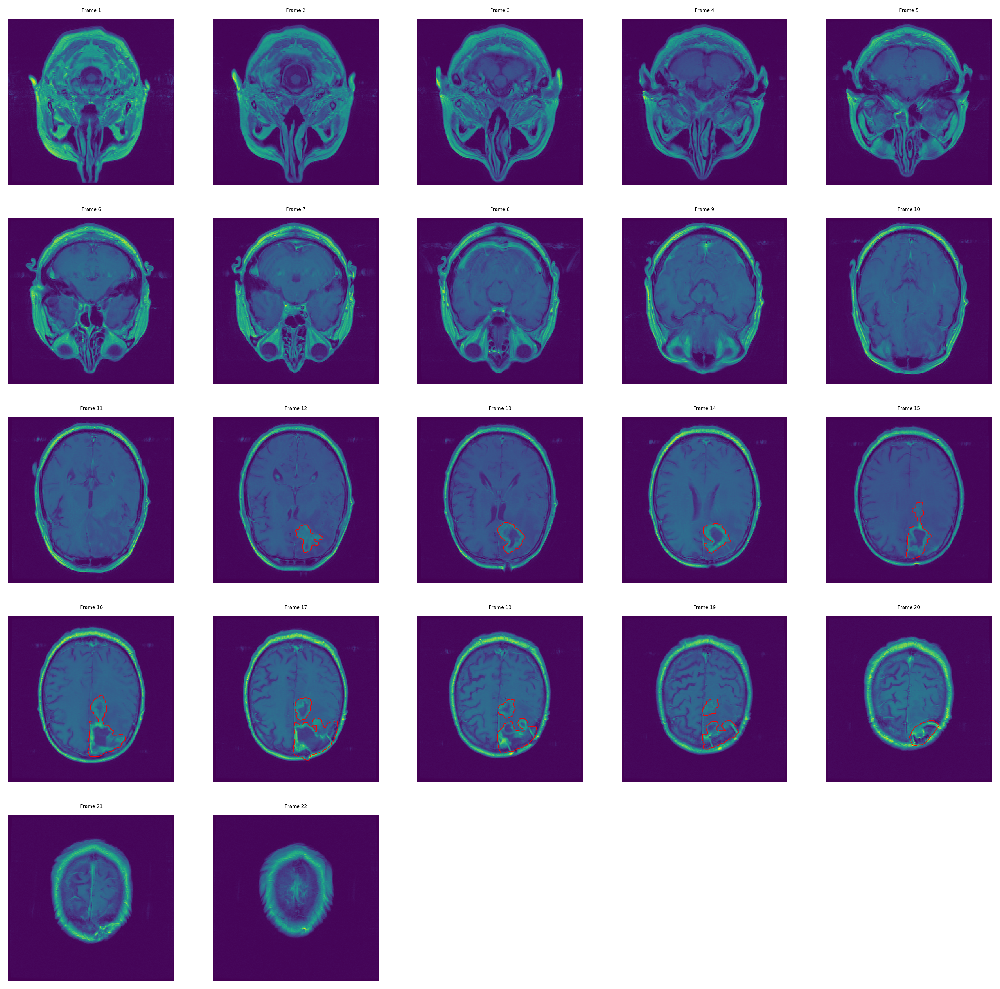

In [117]:
# Configure plot:

# Set the title font:
fontSize=4

Nuids = len(T1postDataDict.keys())

# Set the number of subplot rows and columns:
rows = np.int8(np.round(np.sqrt(Nuids)))
cols = np.int8(np.round(np.sqrt(Nuids)))

plt.figure(figsize=(15,15), dpi=300);

i = 0 # for subplot pos

for uid, values in T1postDataDict.items(): 
    frameNo = values['Frame number']
    pixArray = values['Pixel array']
    Ncontours = values['Number of contours']
    contourPts = values['Contour points']
    
    # Plot the pixel array:
    i = i + 1    
    plt.subplot(rows,cols,i, aspect='equal')
    plt.pcolormesh(pixArray);
    plt.title(f'Frame {frameNo}', size=fontSize);
    plt.axis('off');
    
    # Plot the contours:
    if Ncontours > 0:   
        for c in range(Ncontours):
            # Unpack tuple and store each x,y tuple in arrays xList and yList:
            xList = []
            yList = []
            for x, y in contourPts[c]:
                xList.append(x)
                yList.append(y)

            # Create 2D arrays for the X and Y values using meshgrid:
            #X, Y = np.meshgrid(xList, yList)
            X = xList[:]
            Y = yList[:]

            plt.plot(X, Y, linewidth=0.5, c='red');


seriesDescription = dicom.SeriesDescription

exportFname = projectLabel + ' ' + subjectLabel + ' ' + seriesDescription \
+ ' All frames with ROIs using XNATpy.jpg'

exportFpath = os.path.join(plotsDir, exportFname)

#plt.savefig(exportFpath, bbox_inches='tight')

In [138]:
# Check how many frames are in T1postDicomsDict and T1pre_regDicomsDict:
T1postKeys = list(T1postDicomsDict.keys())
N_T1post = len(T1postKeys)

T1pre_regKeys = list(T1pre_regDicomsDict.keys())
N_T1pre_reg = len(T1pre_regKeys)

print(f'T1post has {N_T1post} frames')
print(f'T1pre_reg has {N_T1pre_reg} frames')

T1post has 22 frames
T1pre_reg has 22 frames


In [150]:
#T1postDicomsDict

# Plot the T1pre_reg DICOM scans with T1post contours overlayed:

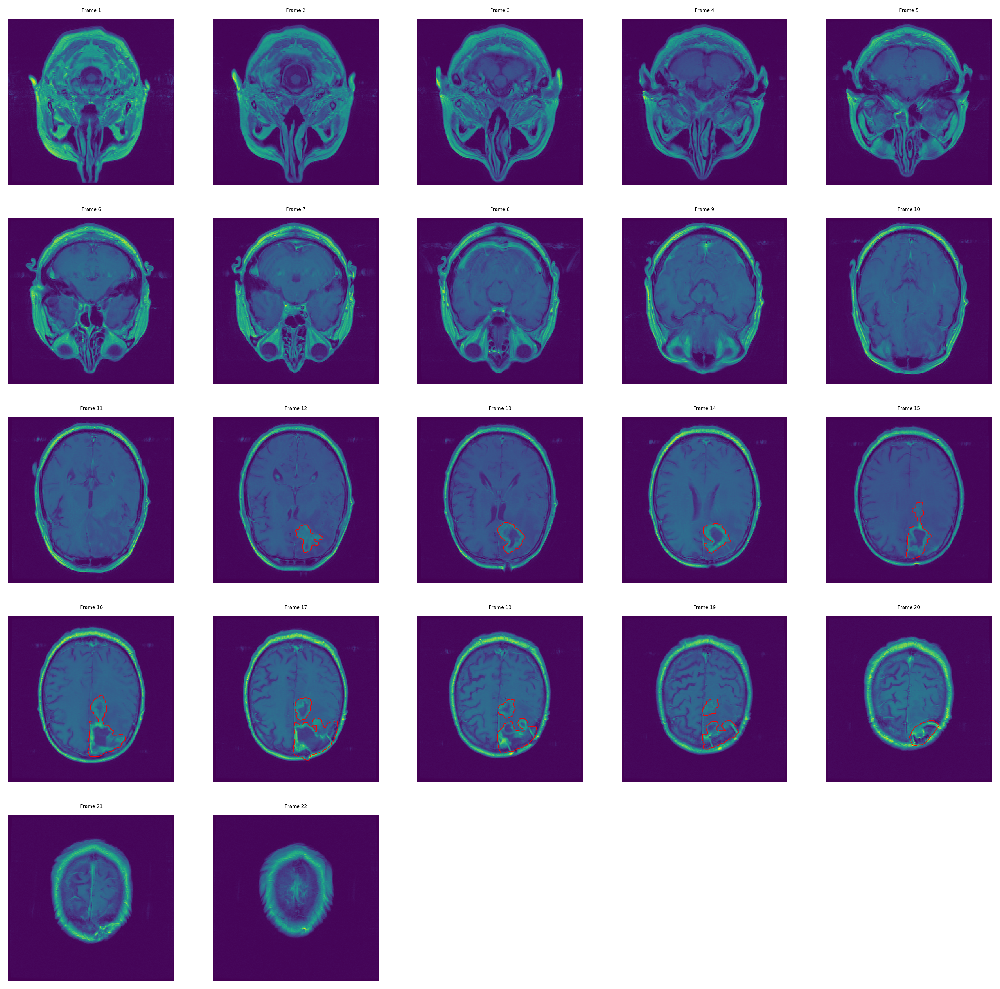

In [117]:
# Configure plot:

# Set the title font:
fontSize=4

Nuids = len(T1postDataDict.keys())

# Set the number of subplot rows and columns:
rows = np.int8(np.round(np.sqrt(Nuids)))
cols = np.int8(np.round(np.sqrt(Nuids)))

plt.figure(figsize=(15,15), dpi=300);

i = 0 # for subplot pos

for uid, values in T1postDataDict.items(): 
    frameNo = values['Frame number']
    pixArray = values['Pixel array']
    Ncontours = values['Number of contours']
    contourPts = values['Contour points']
    
    # Plot the pixel array:
    i = i + 1    
    plt.subplot(rows,cols,i, aspect='equal')
    plt.pcolormesh(pixArray);
    plt.title(f'Frame {frameNo}', size=fontSize);
    plt.axis('off');
    
    # Plot the contours:
    if Ncontours > 0:   
        for c in range(Ncontours):
            # Unpack tuple and store each x,y tuple in arrays xList and yList:
            xList = []
            yList = []
            for x, y in contourPts[c]:
                xList.append(x)
                yList.append(y)

            # Create 2D arrays for the X and Y values using meshgrid:
            #X, Y = np.meshgrid(xList, yList)
            X = xList[:]
            Y = yList[:]

            plt.plot(X, Y, linewidth=0.5, c='red');


seriesDescription = dicom.SeriesDescription

exportFname = projectLabel + ' ' + subjectLabel + ' ' + seriesDescription \
+ ' All frames with ROIs using XNATpy.jpg'

exportFpath = os.path.join(plotsDir, exportFname)

#plt.savefig(exportFpath, bbox_inches='tight')

# Next steps:

### 1.  Modify the coordinates (e.g. 10 pixel shift(s))
### 2.  Convert from image to patient coordinates (reverse previous conversion)
### 3.  Flatten the array for all sequences of contours (get back to ContourData format)
### 4.  Save in DICOM-RTSTRUCT format (using pydicom?)
### 5.  Upload to XNAT using ROIUploaderTool

In [83]:
roi

(0008, 0016) SOP Class UID                       UI: RT Structure Set Storage
(0008, 0018) SOP Instance UID                    UI: 1.2.826.0.1.534147.578.4208788039.20200231457312
(0008, 0020) Study Date                          DA: '19960813'
(0008, 0030) Study Time                          TM: '162908'
(0008, 0050) Accession Number                    SH: ''
(0008, 0060) Modality                            CS: 'RTSTRUCT'
(0008, 0070) Manufacturer                        LO: 'GE MEDICAL SYSTEMS'
(0008, 0090) Referring Physician's Name          PN: ''
(0008, 1070) Operators' Name                     PN: ''
(0008, 1090) Manufacturer's Model Name           LO: 'Optima MR450w'
(0010, 0010) Patient's Name                      PN: 'PGM-002'
(0010, 0020) Patient ID                          LO: 'PGM-002_MR_1'
(0010, 0030) Patient's Birth Date                DA: '00021130'
(0010, 0040) Patient's Sex                       CS: 'M'
(0018, 1020) Software Version(s)                 LO: ['25', 'LX', '

In [86]:
type(roi)

pydicom.dataset.FileDataset

In [88]:
roi2 = roi.copy

In [89]:
type(roi2)

builtin_function_or_method

WTF?

In [90]:
roi2

<function FileDataset.copy>

What?!?

In [92]:
roi.ROIContourSequence[0].ContourSequence[0].ContourImageSequence[0].ReferencedSOPInstanceUID

'1.3.6.1.4.1.14519.5.2.1.4429.7055.320280293613596547840725755465'

In [93]:
roi2.ROIContourSequence[0].ContourSequence[0].ContourImageSequence[0].ReferencedSOPInstanceUID

AttributeError: 'builtin_function_or_method' object has no attribute 'ROIContourSequence'

I don't understand why .copy didn't work.  But I found this:
    
https://github.com/pydicom/pydicom/issues/953

In [94]:
from copy import deepcopy
roi2 = deepcopy(roi)

In [95]:
type(roi2)

pydicom.dataset.FileDataset

That looks better.

In [96]:
roi2.ROIContourSequence[0].ContourSequence[0].ContourImageSequence[0].ReferencedSOPInstanceUID

'1.3.6.1.4.1.14519.5.2.1.4429.7055.320280293613596547840725755465'

Good.  Now I'll try to modify roi2...

In [98]:
roi2.ROIContourSequence[0].ContourSequence[0].ContourData[0:6]

["14.0671471181917",
 "-79.933696238335",
 "15.0146846218467",
 "13.4982279733613",
 "-80.186358271834",
 "15.0312296601049"]

In [99]:
roi2.ROIContourSequence[0].ContourSequence[0].ContourData[0] = "0"

In [100]:
roi2.ROIContourSequence[0].ContourSequence[0].ContourData[0:6]

["0",
 "-79.933696238335",
 "15.0146846218467",
 "13.4982279733613",
 "-80.186358271834",
 "15.0312296601049"]

That seems to have worked.  Now modify the x and y coordinates by some amount:

In [8]:
# Copy roi again:
roi2 = deepcopy(roi)

In [102]:
type(roi2.ROIContourSequence[0].ContourSequence[0].ContourData)

pydicom.multival.MultiValue

In [108]:
pydicom.multival(9)

TypeError: 'module' object is not callable

In [109]:
roi2.ROIContourSequence[0].ContourSequence[0].ContourGeometricType

'CLOSED_PLANAR'

In [110]:
# Loop for each contour sequence:
for sequence in roi2.ROIContourSequence[0].ContourSequence:
    print(sequence.ContourGeometricType)

CLOSED_PLANAR
CLOSED_PLANAR
CLOSED_PLANAR
CLOSED_PLANAR
CLOSED_PLANAR
CLOSED_PLANAR
CLOSED_PLANAR
CLOSED_PLANAR
CLOSED_PLANAR
CLOSED_PLANAR
CLOSED_PLANAR
CLOSED_PLANAR
CLOSED_PLANAR
CLOSED_PLANAR
CLOSED_PLANAR
CLOSED_PLANAR


In [111]:
# Apply a shift in pixels to the x and y coordinates:
pixShift = -5


# Loop for each contour sequence:
for sequence in roi2.ROIContourSequence[0].ContourSequence:
    
    # The contour data for this sequence:
    contourData = sequence.ContourData
    
    print(contourData[0:5]); print('')
    
    # Convert the contour data for this sequence to float:
    #contourData = np.array(contourData).astype(np.float) # --> flat array
    contourData = np.array(contourData).astype(float) # --> flat array
    
    print(contourData[0:5]); print('')
    
    for p in range(0, len(contourData), 3):
        # Shift the x and y pixel coordinates:
        contourData[p] = contourData[p] + pixShift
        contourData[p+1] = contourData[p+1] + pixShift
            
    # Convert the contour data to strings:
    #contourData = contourData.astype(np.str)
    contourData = contourData.astype(str)
    
    print(contourData[0:5]); print('\n\n')

["14.0671471181917", "-79.933696238335", "15.0146846218467", "13.4982279733613", "-80.186358271834"]

[ 14.06714712 -79.93369624  15.01468462  13.49822797 -80.18635827]

['9.0671471181917' '-84.933696238335' '15.0146846218467' '8.4982279733613'
 '-85.186358271834']



["2.01350111991730", "-85.486328474406", "22.0100720586143", "1.76213406079829", "-84.927631968725"]

[  2.01350112 -85.48632847  22.01007206   1.76213406 -84.92763197]

['-2.9864988800827' '-90.486328474406' '22.0100720586143'
 '-3.23786593920171' '-89.927631968725']



["0.32053277645602", "-84.024945026750", "28.2760165572310", "0.06916571733704", "-83.466248521069"]

[ 3.20532776e-01 -8.40249450e+01  2.82760166e+01  6.91657173e-02
 -8.34662485e+01]

['-4.67946722354398' '-89.02494502675' '28.276016557231'
 '-4.93083428266296' '-88.466248521069']



["-3.3714071185029", "-89.349789876978", "35.6464527805181", "-3.9270892580148", "-89.328440901505"]

[ -3.37140712 -89.34978988  35.64645278  -3.92708926 -89.3284409 ]

['

I don't understand why the conversion to float is flattening the array...

Try again with separate commands:

In [113]:
roi2.ROIContourSequence[0].ContourSequence[0].ContourData

['14.0671471181917', '-79.933696238335', '15.0146846218467', '13.4982279733613', '-80.186358271834', '15.0312296601049', '13.1939128929684', '-80.723705802041', '15.1114242208178', '12.8763608072570', '-81.535064341221', '15.2395668092532', '12.2942046571081', '-82.061737383692', '15.3040598752340', '11.9898895767152', '-82.5990849139', '15.3842544359469', '11.6855744963223', '-83.136432444107', '15.4644489966598', '11.1166553514919', '-83.389094477606', '15.4809940349181', '10.5477362066615', '-83.641756511105', '15.4975390731763', '9.99205406714968', '-83.620407535631', '15.4661360837120', '9.42313492231928', '-83.873069569130', '15.4826811219702', '8.85421577748893', '-84.125731602629', '15.4992261602284', '8.28529663265856', '-84.378393636127', '15.5157711984867', '7.71637748782816', '-84.631055669626', '15.5323162367449', '7.41206240743527', '-85.168403199834', '15.6125107974578', '6.57853919816741', '-85.136379736624', '15.5654063132613', '6.02285705865550', '-85.115030761150', '

In [116]:
np.array(roi2.ROIContourSequence[0].ContourSequence[0].ContourData).astype(float)

array([ 1.40671471e+01, -7.99336962e+01,  1.50146846e+01,  1.34982280e+01,
       -8.01863583e+01,  1.50312297e+01,  1.31939129e+01, -8.07237058e+01,
        1.51114242e+01,  1.28763608e+01, -8.15350643e+01,  1.52395668e+01,
        1.22942047e+01, -8.20617374e+01,  1.53040599e+01,  1.19898896e+01,
       -8.25990849e+01,  1.53842544e+01,  1.16855745e+01, -8.31364324e+01,
        1.54644490e+01,  1.11166554e+01, -8.33890945e+01,  1.54809940e+01,
        1.05477362e+01, -8.36417565e+01,  1.54975391e+01,  9.99205407e+00,
       -8.36204075e+01,  1.54661361e+01,  9.42313492e+00, -8.38730696e+01,
        1.54826811e+01,  8.85421578e+00, -8.41257316e+01,  1.54992262e+01,
        8.28529663e+00, -8.43783936e+01,  1.55157712e+01,  7.71637749e+00,
       -8.46310557e+01,  1.55323162e+01,  7.41206241e+00, -8.51684032e+01,
        1.56125108e+01,  6.57853920e+00, -8.51363797e+01,  1.55654063e+01,
        6.02285706e+00, -8.51150308e+01,  1.55340033e+01,  5.46717492e+00,
       -8.50936818e+01,  

In [117]:
np.array(roi2.ROIContourSequence[0].ContourSequence[0].ContourData).astype(float)[0:5]

array([ 14.06714712, -79.93369624,  15.01468462,  13.49822797,
       -80.18635827])

It's not flat!  So why was it flattened in the for loop above?!

This time replicate the lines in the loop:

In [118]:
# Work with the contour data in the first contour sequence:
contourData = roi2.ROIContourSequence[0].ContourSequence[0].ContourData

contourData

['14.0671471181917', '-79.933696238335', '15.0146846218467', '13.4982279733613', '-80.186358271834', '15.0312296601049', '13.1939128929684', '-80.723705802041', '15.1114242208178', '12.8763608072570', '-81.535064341221', '15.2395668092532', '12.2942046571081', '-82.061737383692', '15.3040598752340', '11.9898895767152', '-82.5990849139', '15.3842544359469', '11.6855744963223', '-83.136432444107', '15.4644489966598', '11.1166553514919', '-83.389094477606', '15.4809940349181', '10.5477362066615', '-83.641756511105', '15.4975390731763', '9.99205406714968', '-83.620407535631', '15.4661360837120', '9.42313492231928', '-83.873069569130', '15.4826811219702', '8.85421577748893', '-84.125731602629', '15.4992261602284', '8.28529663265856', '-84.378393636127', '15.5157711984867', '7.71637748782816', '-84.631055669626', '15.5323162367449', '7.41206240743527', '-85.168403199834', '15.6125107974578', '6.57853919816741', '-85.136379736624', '15.5654063132613', '6.02285705865550', '-85.115030761150', '

In [119]:
# Convert to float:
contourData = np.array(contourData).astype(float)

contourData

array([ 1.40671471e+01, -7.99336962e+01,  1.50146846e+01,  1.34982280e+01,
       -8.01863583e+01,  1.50312297e+01,  1.31939129e+01, -8.07237058e+01,
        1.51114242e+01,  1.28763608e+01, -8.15350643e+01,  1.52395668e+01,
        1.22942047e+01, -8.20617374e+01,  1.53040599e+01,  1.19898896e+01,
       -8.25990849e+01,  1.53842544e+01,  1.16855745e+01, -8.31364324e+01,
        1.54644490e+01,  1.11166554e+01, -8.33890945e+01,  1.54809940e+01,
        1.05477362e+01, -8.36417565e+01,  1.54975391e+01,  9.99205407e+00,
       -8.36204075e+01,  1.54661361e+01,  9.42313492e+00, -8.38730696e+01,
        1.54826811e+01,  8.85421578e+00, -8.41257316e+01,  1.54992262e+01,
        8.28529663e+00, -8.43783936e+01,  1.55157712e+01,  7.71637749e+00,
       -8.46310557e+01,  1.55323162e+01,  7.41206241e+00, -8.51684032e+01,
        1.56125108e+01,  6.57853920e+00, -8.51363797e+01,  1.55654063e+01,
        6.02285706e+00, -8.51150308e+01,  1.55340033e+01,  5.46717492e+00,
       -8.50936818e+01,  

It's not flat.

In [120]:
print(contourData[0:5])

[ 14.06714712 -79.93369624  15.01468462  13.49822797 -80.18635827]


So it's the printing that gives the appearance of a flat array!

In [121]:
print(contourData)

[ 1.40671471e+01 -7.99336962e+01  1.50146846e+01  1.34982280e+01
 -8.01863583e+01  1.50312297e+01  1.31939129e+01 -8.07237058e+01
  1.51114242e+01  1.28763608e+01 -8.15350643e+01  1.52395668e+01
  1.22942047e+01 -8.20617374e+01  1.53040599e+01  1.19898896e+01
 -8.25990849e+01  1.53842544e+01  1.16855745e+01 -8.31364324e+01
  1.54644490e+01  1.11166554e+01 -8.33890945e+01  1.54809940e+01
  1.05477362e+01 -8.36417565e+01  1.54975391e+01  9.99205407e+00
 -8.36204075e+01  1.54661361e+01  9.42313492e+00 -8.38730696e+01
  1.54826811e+01  8.85421578e+00 -8.41257316e+01  1.54992262e+01
  8.28529663e+00 -8.43783936e+01  1.55157712e+01  7.71637749e+00
 -8.46310557e+01  1.55323162e+01  7.41206241e+00 -8.51684032e+01
  1.56125108e+01  6.57853920e+00 -8.51363797e+01  1.55654063e+01
  6.02285706e+00 -8.51150308e+01  1.55340033e+01  5.46717492e+00
 -8.50936818e+01  1.55026003e+01  4.91149278e+00 -8.50723328e+01
  1.54711973e+01  4.35581064e+00 -8.50509838e+01  1.54397944e+01
  3.80012850e+00 -8.50296

Even if I don't print just the first 5 elements.

In that case continue where I left off:

In [124]:
# Apply a shift in pixels to the x and y coordinates:
pixShift = -5


# Loop for each contour sequence:
for sequence in roi2.ROIContourSequence[0].ContourSequence:
    
    # The contour data for this sequence:
    contourData = sequence.ContourData
    
    #print(contourData[0:5]); print('')
    
    # Convert the contour data for this sequence to float:
    #contourData = np.array(contourData).astype(np.float) # --> flat array
    contourData = np.array(contourData).astype(float) # --> flat array
    
    #print(contourData[0:5]); print('')
    
    for p in range(0, len(contourData), 3):
        # Shift the x and y pixel coordinates:
        contourData[p] = contourData[p] + pixShift
        contourData[p+1] = contourData[p+1] + pixShift
            
    # Convert the contour data to strings:
    #contourData = contourData.astype(np.str)
    contourData = contourData.astype(str)
    
    #print(contourData[0:5]); print('\n\n')

    # Overwrite the contour data for this sequence with the modified contourData:
    #sequence.ContourData = contourData # ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()
    #sequence.ContourData = contourData.all() # TypeError: cannot perform reduce with flexible type
    
    # Since it didn't like those commands instead just replace the first entry as I had
    # done so previously:
    sequence.ContourData[0] = contourData[0]

It didn't mind that.

Compare the first contour sequence in roi with that of roi2:

In [126]:
roi.ROIContourSequence[0].ContourSequence[0].ContourData[0:5]

["14.0671471181917",
 "-79.933696238335",
 "15.0146846218467",
 "13.4982279733613",
 "-80.186358271834"]

In [127]:
roi2.ROIContourSequence[0].ContourSequence[0].ContourData[0:5]

["9.0671471181917",
 "-79.933696238335",
 "15.0146846218467",
 "13.4982279733613",
 "-80.186358271834"]

OK so it worked but it's still not clear why I couldn't replace all values in sequence.ContourData with contourData or contourData.all.

Loop over each element in ContourData then:

In [9]:
# Apply a shift in pixels to the x and y coordinates:
pixShift = -5


# Loop for each contour sequence:
for sequence in roi2.ROIContourSequence[0].ContourSequence:
    
    # The contour data for this sequence:
    contourData = sequence.ContourData
    
    #print(contourData[0:5]); print('')
    
    # Convert the contour data for this sequence to float:
    #contourData = np.array(contourData).astype(np.float) # --> flat array
    contourData = np.array(contourData).astype(float) # --> flat array
    
    #print(contourData[0:5]); print('')
    
    for p in range(0, len(contourData), 3):
        # Shift the x and y pixel coordinates:
        contourData[p] = contourData[p] + pixShift
        contourData[p+1] = contourData[p+1] + pixShift
            
    # Convert the contour data to strings:
    #contourData = contourData.astype(np.str)
    contourData = contourData.astype(str)
    
    #print(contourData[0:5]); print('\n\n')

    # Overwrite the contour data for this sequence with the modified contourData:
    #sequence.ContourData = contourData # ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()
    #sequence.ContourData = contourData.all() # TypeError: cannot perform reduce with flexible 
    
    # Since it didn't like those commands instead just replace the first entry as I had
    # done so previously:
    #sequence.ContourData[0] = contourData[0]
    
    # Since the above single replacement worked (and not the replacement with all entries),
    # loop over each element and replace element-wise:
    for i in range(len(contourData)):
        sequence.ContourData[i] = contourData[i]

Compare the first contour sequence in roi with that of roi2:

In [10]:
roi.ROIContourSequence[0].ContourSequence[0].ContourData[0:5]

["14.0671471181917",
 "-79.933696238335",
 "15.0146846218467",
 "13.4982279733613",
 "-80.186358271834"]

In [11]:
roi2.ROIContourSequence[0].ContourSequence[0].ContourData[0:5]

["9.0671471181917",
 "-84.933696238335",
 "15.0146846218467",
 "8.4982279733613",
 "-85.186358271834"]

Looks fine.  

To make life easier I'll also change the date so I can easily tell the original from the modified RTSTRUCT file.

In [16]:
roi2.StudyDate

'19960813'

In [17]:
roi2.StudyDate = '20200214'

In [18]:
roi2.StudyDate

'20200214'

When trying to upload the modified file I'm getting a message "Upload item 'PGM-002_MR_1_Tumor' with label 'RTSTRUCT_20200123_145731' already exists".  So I'll also modify the Structure Set Date and Structure Set Time:

In [21]:
roi2.StructureSetDate

'20200123'

In [22]:
roi2.StructureSetTime

'145731'

In [23]:
roi2.StructureSetDate = '20200214'

In [24]:
roi2.StructureSetTime = '214100'

In [25]:
roi2.StructureSetDate

'20200214'

In [26]:
roi2.StructureSetTime

'214100'

Now just need to save roi2:

In [13]:
# Assign the filename and filepath:
roiModifiedFname = 'AIM_20200123_145716_modified.dcm'

roiModifiedFpath = os.path.join(roiPath, roiModifiedFname)

roiModifiedFpath

'C:\\Users\\ctorti\\Documents\\GitHub\\WP1.3_multiple_modalities\\trying stuff\\XNAT downloads\\BrainTumorProg\\PGM-002\\0\\0\\AIM_20200123_145716\\out\\resources\\RTSTRUCT\\files\\AIM_20200123_145716_modified.dcm'

In [27]:
roi2.save_as(roiModifiedFpath)

The file was uploaded succcesfully.  I imported both the original and modified ROIs in the OHIF-Viewer (it wasn't obvious which was which since they had the same labels in the viewer) and the original and modified contours appeared in blue and red, confirming that the modified contours appear as expected.